# Skilled Nursing Facility Violations

![Untitled%20%28Presentation%20(169%29)%20(1920%20%C3%97%20500%20px).png](attachment:Untitled%20%28Presentation%20(169%29)%20(1920%20%C3%97%20500%20px).png)
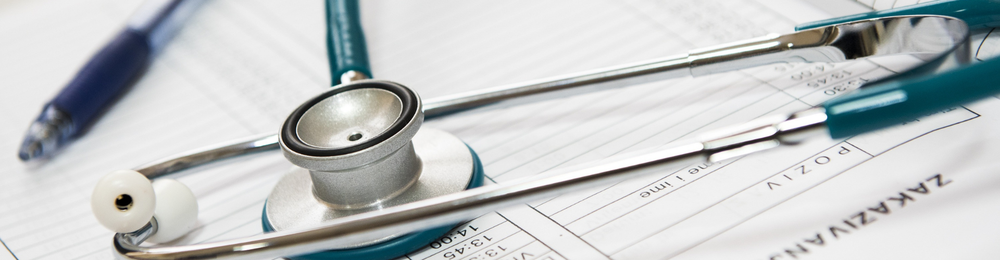

### Import Packages

In [304]:
import numpy as np
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import datetime
import time

import warnings
warnings.filterwarnings("ignore")

from sklearn import linear_model
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor


##HELPER FUNCTIONS##
def create_histogram(df, column_name, title):
    '''
    Input dataframe, column name to build histogram off of, and graph title.
    Outputs nicely styled histogram for project.
    '''
    #styling
    plt.rcParams['font.family'] = 'sans-serif'
    plt.rcParams['font.sans-serif'] = 'Helvetica'
    plt.figure(figsize=(10, 5))
    #graph
    plt.hist(df[column_name], color = '#3C4F76', bins=100)
    #titling
    plt.xlabel('Percentage', fontsize=12, fontweight='black', color = '#333F4B')
    plt.ylabel('Count of Reports',fontsize=12, fontweight='black', color = '#333F4B')
    plt.title(title.title(), fontsize=15, fontweight='black', color = '#333F4B', pad=10)
    return plt

### Import Data

##### Data Cleaning Explanation
It's necessary to separate out the long-stay and short-stay residents since they have separate measures. I'd expect they would also have very different outcomes in this data since they have different experiences within the Skilled Nursing Facilities. 

For the purposes of this analysis, I'll be focusing on long-stay patients.
 
##### Why use CSVs and not the CMS apis available? 
I would have liked to use the CMS apis to make the data ingestion process cleaner and more easily replicated by another user of this file. However, given the fact that I am using so much data, I decided it wouldn't be wise to use their apis to export data when there is a bulk download option in the form of csv files.

In [180]:
class import_and_clean:
    '''
    Ingests CMS data from CSVs containing 'NH_QualityMsr_MDS' in name and cleans data.
    
    Class inputs are data_location, data_year, and the resident type (short-term vs long term).
    '''
    def __init__(self, data_location, data_year, resident_type):
        self.data_location = data_location
        self.year = data_year
        self.resident_type = resident_type
        
    def read_file(self):
        df = pd.read_csv(self.data_location, encoding='cp1252', dtype={'Federal Provider Number': 'str'})

        #Separating out residents by group: Long vs Short-stay patients
        stay = df[df['Measure Description'].str.contains(self.resident_type)]

        #Remove currently unnecessary fields
        stay = stay[['Federal Provider Number', 'Provider Name', 'Measure Code','Measure Description',
                     'Q1 Measure Score','Q2 Measure Score','Q3 Measure Score','Q4 Measure Score','Four Quarter Average Score']]

        #Combine description & code into one field for ease of use
        stay['code_description'] = stay['Measure Code'].astype(str) + ' ' + stay['Measure Description']
        return stay
    
    def pivot_quarters(self):
        '''
        Pivot data from long to wide format
        '''
        df = self.read_file()
        #set filter for quarter based on input
        quarter_filter = 'Four Quarter Average Score'
        #pivot
        pivot_df = pd.pivot(df, columns = ['code_description'], 
                            index = ['Federal Provider Number','Provider Name'], 
                            values = [quarter_filter])
        #reset column names & add new columns
        pivot_df.columns = pivot_df.columns.get_level_values(1)
        pivot_df = pivot_df.reset_index()
        pivot_df['Quarter'] = quarter_filter.upper()
        pivot_df['Year'] = self.year
        return pivot_df

In [181]:
#load provider info
def load_provider_info(filepath):
    '''
    Intakes provider information csv.
    Outputs cleaned, shortened dataframe.
    '''
    df = pd.read_csv(filepath ,encoding='cp1252')
    df = df[['Federal Provider Number','Provider Address','Provider City', 'Provider State', 'Provider Zip Code',
       'Provider County Name', 'Ownership Type', 'Number of Certified Beds','Average Number of Residents per Day','Provider Type',
       'Provider Resides in Hospital', 'Date First Approved to Provide Medicare and Medicaid Services','Continuing Care Retirement Community', 'Special Focus Status',
       'Abuse Icon', 'Most Recent Health Inspection More Than 2 Years Ago','Provider Changed Ownership in Last 12 Months','With a Resident and Family Council','Overall Rating','Health Inspection Rating',
       'Staffing Rating', 'RN Staffing Rating','Reported Nurse Aide Staffing Hours per Resident per Day',
       'Reported LPN Staffing Hours per Resident per Day','Reported RN Staffing Hours per Resident per Day',
       'Reported Licensed Staffing Hours per Resident per Day','Reported Total Nurse Staffing Hours per Resident per Day',
       'Reported Physical Therapist Staffing Hours per Resident Per Day','Case-Mix Nurse Aide Staffing Hours per Resident per Day',
       'Case-Mix LPN Staffing Hours per Resident per Day','Case-Mix RN Staffing Hours per Resident per Day',
       'Case-Mix Total Nurse Staffing Hours per Resident per Day','Adjusted Nurse Aide Staffing Hours per Resident per Day',
       'Adjusted LPN Staffing Hours per Resident per Day', 'Adjusted RN Staffing Hours per Resident per Day',
       'Adjusted Total Nurse Staffing Hours per Resident per Day','Number of Facility Reported Incidents','Number of Substantiated Complaints',
       'Number of Citations from Infection Control Inspections', 'Number of Fines', 'Total Amount of Fines in Dollars','Total Number of Penalties']]
    df['Federal Provider Number']= df['Federal Provider Number'].astype(str)
    df['Date First Approved to Provide Medicare and Medicaid Services'] = pd.to_datetime(df['Date First Approved to Provide Medicare and Medicaid Services'])
    df['time_diff']= (pd.Timestamp.now() - pd.to_datetime(df['Date First Approved to Provide Medicare and Medicaid Services'], 
                              errors='coerce')).dt.days
    
    return df

prov_df = load_provider_info('data/NH_ProviderInfo_Apr2021.csv')

In [182]:
# Facility Quality Data
import_file = import_and_clean('data/NH_QualityMsr_MDS_Apr2022.csv', '2021', 'long-stay')
df = import_file.pivot_quarters()

#Provider Data
prov_df = load_provider_info('data/NH_ProviderInfo_Apr2021.csv')

In [183]:
print(df.shape)
print(prov_df.shape)

(15203, 18)
(15328, 43)


In [204]:
# I decided to keep only facilities that had values in both data sets
# This removed 64 facilities
all_measures = df.merge(prov_df, on = 'Federal Provider Number', how = 'inner')

In [205]:
print("Merge results in loss of ", all_measures.shape[0] - df.shape[0], ' measures')

Merge results in loss of  -64  measures


## Investigating Data

Looking at the data information below, there are more instances of measure scores as the quarters progress (example: Q1 Measure Score has 182,661 non-null objects while Q4 Measure Score has 185,900). This could be due to more skilled nursing facilities being added to CMS database as the year went on, but this will need to be investigated further.

There are no nulls in the many of the data columns so at first glance, this looks like a very well maintained database which is a good sign.

In [188]:
all_measures.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15139 entries, 0 to 15138
Data columns (total 60 columns):
 #   Column                                                                                                 Non-Null Count  Dtype         
---  ------                                                                                                 --------------  -----         
 0   Federal Provider Number                                                                                15139 non-null  object        
 1   Provider Name                                                                                          15139 non-null  object        
 2   401 Percentage of long-stay residents whose need for help with daily activities has increased          14632 non-null  float64       
 3   404 Percentage of long-stay residents who lose too much weight                                         14683 non-null  float64       
 4   405 Percentage of low risk long-stay residents who l

Measures 406, 407, 409, and 410 are reported very infrequently based on the summary statistics below. However, there are some facilities based on this data that are seeing a good number of these issues so I don't want to totally eliminate the columns yet.

In [189]:
all_measures.describe()

,401 Percentage of long-stay residents whose need for help with daily activities has increased,404 Percentage of long-stay residents who lose too much weight,405 Percentage of low risk long-stay residents who lose control of their bowels or bladder,406 Percentage of long-stay residents with a catheter inserted and left in their bladder,407 Percentage of long-stay residents with a urinary tract infection,408 Percentage of long-stay residents who have depressive symptoms,409 Percentage of long-stay residents who were physically restrained,410 Percentage of long-stay residents experiencing one or more falls with major injury,415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine,419 Percentage of long-stay residents who received an antipsychotic medication,...,Adjusted LPN Staffing Hours per Resident per Day,Adjusted RN Staffing Hours per Resident per Day,Adjusted Total Nurse Staffing Hours per Resident per Day,Number of Facility Reported Incidents,Number of Substantiated Complaints,Number of Citations from Infection Control Inspections,Number of Fines,Total Amount of Fines in Dollars,Total Number of Penalties,time_diff
count,14632.000000,14683.000000,14151.000000,14705.000000,14720.000000,14708.000000,14727.000000,14730.000000,14730.000000,14692.000000,...,14394.000000,14394.000000,14394.000000,15139.000000,15139.000000,15113.000000,15139.000000,1.513900e+04,15139.000000,15139.000000
mean,14.841888,6.285475,47.009018,1.526194,2.385768,7.375505,0.162730,3.386303,92.978360,14.490840,...,0.948401,0.802360,4.087864,1.349561,4.159786,1.043737,0.484973,1.261060e+04,0.590528,11423.927274
std,6.795640,3.852442,17.905278,1.839692,2.627828,14.328618,1.555499,2.574797,12.360009,9.918476,...,0.391532,0.545952,1.011510,3.329051,7.765601,1.868884,0.855659,4.425362e+04,1.012300,4754.051177
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.721153,0.000000,...,0.000000,0.000000,1.302360,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,408.000000
25%,10.094637,3.571429,34.729532,0.294744,0.564971,0.363637,0.000000,1.544899,91.915969,8.034817,...,0.696865,0.453860,3.429428,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,8482.000000
50%,14.285716,5.785125,47.058822,1.000612,1.602197,2.365864,0.000000,2.941177,98.218924,12.941175,...,0.925070,0.670020,3.938710,0.000000,1.000000,0.000000,0.000000,0.000000e+00,0.000000,11236.000000
75%,19.021738,8.333335,59.090908,2.108500,3.303923,7.102252,0.000000,4.741380,100.000000,18.881120,...,1.167100,1.001765,4.558872,1.000000,5.000000,1.000000,1.000000,6.893000e+03,1.000000,14905.000000
max,63.636360,44.347824,100.000000,33.871746,28.947367,100.000000,100.000000,33.333334,100.000000,100.000000,...,5.794250,7.522240,12.693550,77.000000,138.000000,24.000000,9.000000,1.258368e+06,10.000000,20214.000000


In [197]:
all_measures.shape

(15139, 60)

There are quite a few missing values out of the 15,203 reports. What this means will need to be investigated.

In [186]:
all_measures.isnull().sum().sort_values()

Federal Provider Number                                                                                      0
Provider Zip Code                                                                                            0
Provider County Name                                                                                         0
Ownership Type                                                                                               0
Number of Certified Beds                                                                                     0
Provider Type                                                                                                0
Provider Resides in Hospital                                                                                 0
Date First Approved to Provide Medicare and Medicaid Services                                                0
Provider State                                                                                               0
T

One of the first thing that stood out to me was the fact that some of the categories had a lot of zeros. For a measure like depressive symptoms, there would seem to be a low probability that there could actually be a facility where no one has any symptoms at all of depression considering it is such a prevalent condition.

It's possible that some fascilities are using "0" as essentially a null placeholder meaning they aren't reporting that metric publically. I wouldn't have a way to confirm this though unfortunately. I did test what the distribution looks like if you remove rows that have 7 or more missing values or values that are 0 and many of the graphs look far more normalized and they have less of a right skew.

In [233]:
float_columns = all_measures.select_dtypes(float).columns

for column in float_columns:
    all_measures[column] = all_measures[column].replace(0, np.nan)

In [234]:
float_columns = all_measures.select_dtypes(float).columns

for column in float_columns:
    all_measures[column] = all_measures[column].replace(0, np.nan)

reduce_outliers = all_measures.dropna(thresh = 52)
print(reduce_outliers.shape)
print('This eliminates', all_measures.shape[0] - reduce_outliers.shape[0], 'records or', round((all_measures.shape[0] - reduce_outliers.shape[0])/all_measures.shape[0]*100), '%')

for column in float_columns:
    all_measures[column] = all_measures[column].fillna(0)

(13972, 60)
This eliminates 1167 records or 8 %


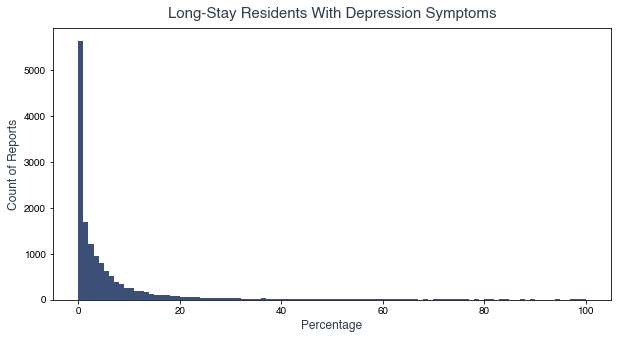

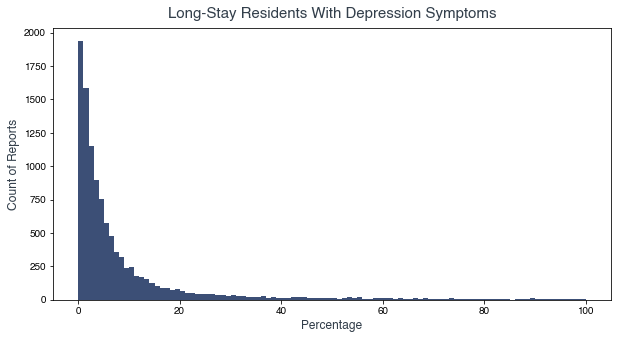

In [235]:
## Outlier included
examp = create_histogram(all_measures, 
                         '408 Percentage of long-stay residents who have depressive symptoms', 
                         'Long-Stay Residents with Depression Symptoms')

examp = create_histogram(reduce_outliers, 
                         '408 Percentage of long-stay residents who have depressive symptoms', 
                         'Long-Stay Residents with Depression Symptoms')

Depression has is far more of a right-skew than many of the other measures

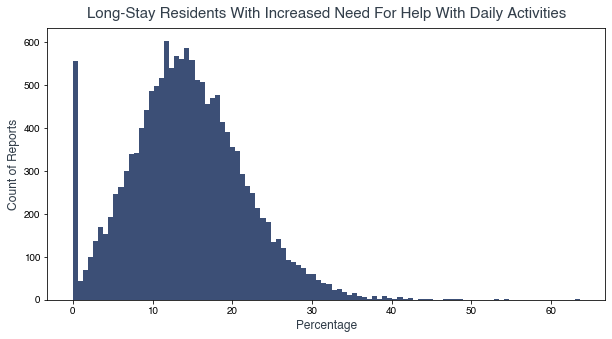

In [236]:
examp = create_histogram(all_measures, 
                         '401 Percentage of long-stay residents whose need for help with daily activities has increased', 
                         'Long-Stay Residents with Increased Need for Help with Daily Activities')

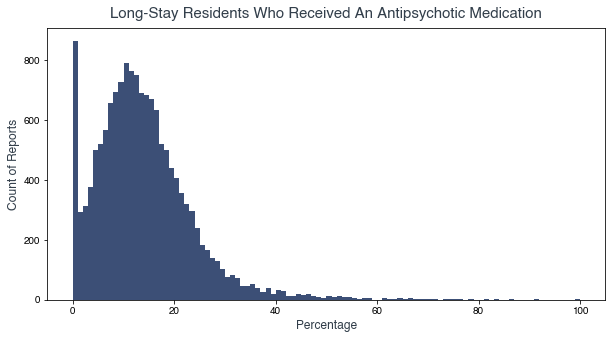

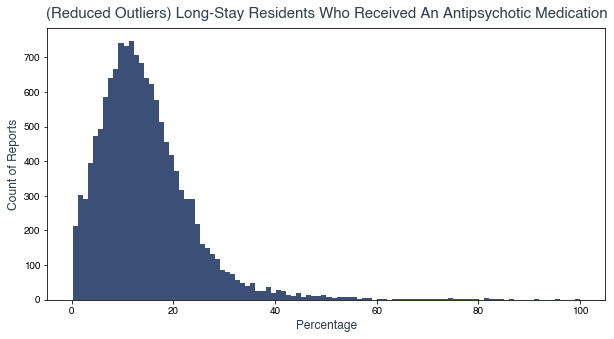

In [224]:
examp = create_histogram(all_measures, 
                         '419 Percentage of long-stay residents who received an antipsychotic medication', 
                         'long-stay residents who received an antipsychotic medication')

examp = create_histogram(reduce_outliers, 
                         '419 Percentage of long-stay residents who received an antipsychotic medication', 
                         '(Reduced Outliers) long-stay residents who received an antipsychotic medication')

We see the same trend with measurements around weight-loss. 

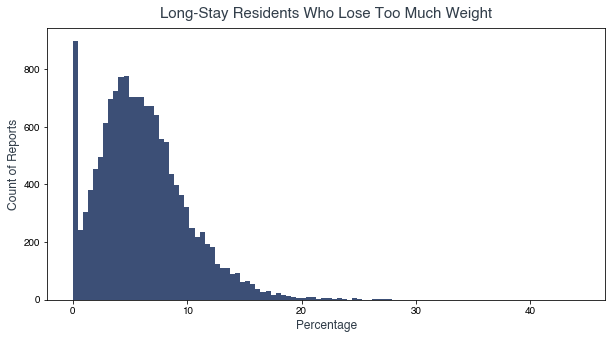

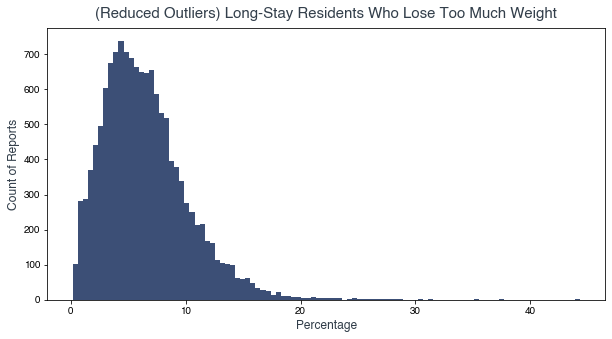

In [225]:
examp = create_histogram(all_measures, 
                         '404 Percentage of long-stay residents who lose too much weight', 
                         'long-stay residents who lose too much weight')

examp = create_histogram(reduce_outliers, 
                         '404 Percentage of long-stay residents who lose too much weight', 
                         '(Reduced Outliers) long-stay residents who lose too much weight')

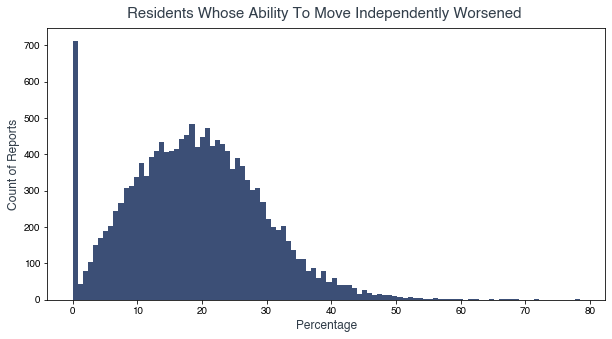

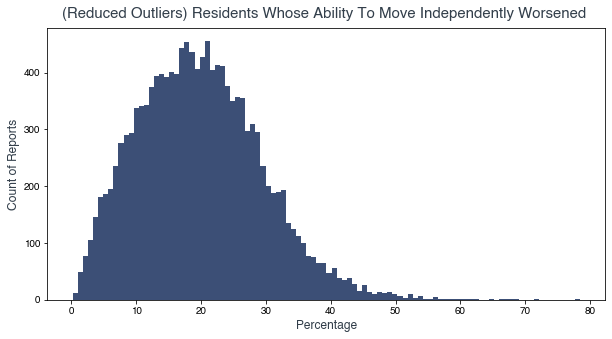

In [228]:
examp = create_histogram(all_measures, 
                         '451 Percentage of long-stay residents whose ability to move independently worsened', 
                         'residents whose ability to move independently worsened ')

examp = create_histogram(reduce_outliers, 
                         '451 Percentage of long-stay residents whose ability to move independently worsened', 
                         '(Reduced Outliers) residents whose ability to move independently worsened ')

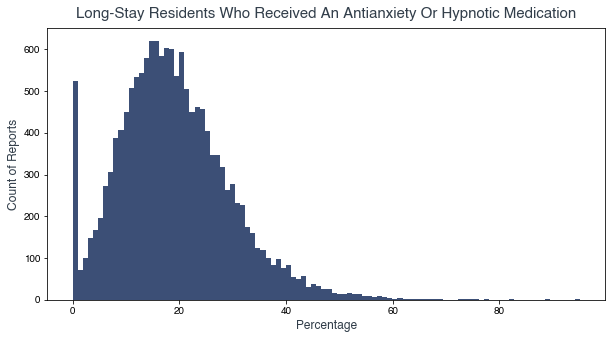

In [229]:
examp = create_histogram(all_measures, 
                         '452 Percentage of long-stay residents who received an antianxiety or hypnotic medication', 
                         'long-stay residents who received an antianxiety or hypnotic medication')

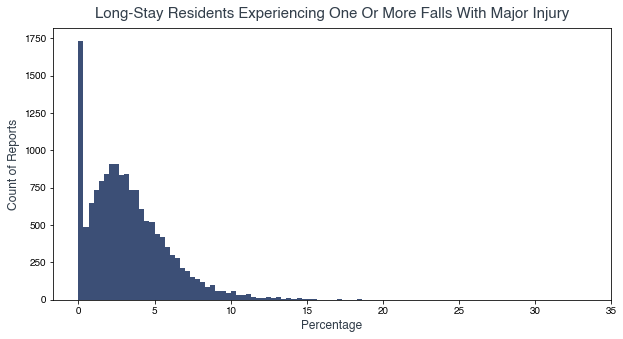

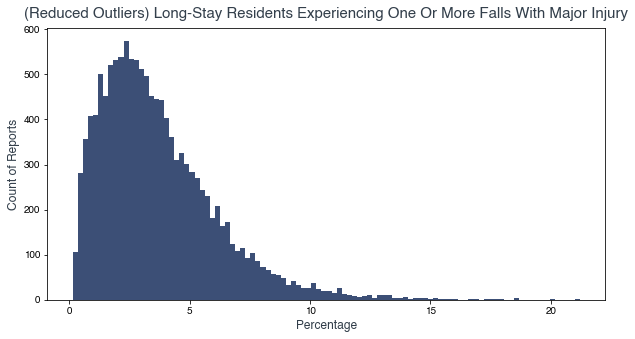

In [230]:
examp = create_histogram(all_measures, 
                         '410 Percentage of long-stay residents experiencing one or more falls with major injury', 
                         'long-stay residents experiencing one or more falls with major injury')

examp = create_histogram(reduce_outliers, 
                         '410 Percentage of long-stay residents experiencing one or more falls with major injury', 
                         '(Reduced Outliers) long-stay residents experiencing one or more falls with major injury')

In [237]:
print(str(round((all_measures[all_measures['408 Percentage of long-stay residents who have depressive symptoms']<1].shape[0] 
      / all_measures.shape[0]) * 100)) + '% of reports on depressive symptoms reported less than 1%.')

print('However, in the reduced outliers set, ', str(round((reduce_outliers[reduce_outliers['408 Percentage of long-stay residents who have depressive symptoms']<1].shape[0] 
      / reduce_outliers.shape[0]) * 100)) + '% of reports on depressive symptoms reported less than 1%.')

37% of reports on depressive symptoms reported less than 1%.
However, in the reduced outliers set,  13% of reports on depressive symptoms reported less than 1%.


In [238]:
reduce_outliers.corr()

,401 Percentage of long-stay residents whose need for help with daily activities has increased,404 Percentage of long-stay residents who lose too much weight,405 Percentage of low risk long-stay residents who lose control of their bowels or bladder,406 Percentage of long-stay residents with a catheter inserted and left in their bladder,407 Percentage of long-stay residents with a urinary tract infection,408 Percentage of long-stay residents who have depressive symptoms,409 Percentage of long-stay residents who were physically restrained,410 Percentage of long-stay residents experiencing one or more falls with major injury,415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine,419 Percentage of long-stay residents who received an antipsychotic medication,...,Adjusted LPN Staffing Hours per Resident per Day,Adjusted RN Staffing Hours per Resident per Day,Adjusted Total Nurse Staffing Hours per Resident per Day,Number of Facility Reported Incidents,Number of Substantiated Complaints,Number of Citations from Infection Control Inspections,Number of Fines,Total Amount of Fines in Dollars,Total Number of Penalties,time_diff
401 Percentage of long-stay residents whose need for help with daily activities has increased,1.000000,0.144189,0.051540,0.042529,0.075330,-0.024034,0.007198,0.102817,-0.167187,0.095299,...,-0.032627,-0.085235,-0.091296,-0.039271,-0.001563,0.079878,0.085391,0.075834,0.090144,-0.104857
404 Percentage of long-stay residents who lose too much weight,0.144189,1.000000,0.089361,0.026695,0.093533,0.022389,-0.004250,0.084604,-0.081590,0.016131,...,0.005360,-0.023095,-0.037458,-0.013631,0.006307,0.022552,0.033636,0.042556,0.031471,-0.005343
405 Percentage of low risk long-stay residents who lose control of their bowels or bladder,0.051540,0.089361,1.000000,-0.034350,0.024439,-0.077669,-0.018393,0.044116,0.032804,-0.112644,...,0.008154,0.163061,0.050176,-0.043716,-0.080395,-0.050744,0.014382,-0.009156,-0.006298,-0.034911
406 Percentage of long-stay residents with a catheter inserted and left in their bladder,0.042529,0.026695,-0.034350,1.000000,0.226850,-0.046239,0.078141,0.103362,0.017836,0.057042,...,0.003956,0.161367,0.185377,-0.037355,-0.083546,-0.025711,-0.043254,-0.041784,-0.036968,-0.101562
407 Percentage of long-stay residents with a urinary tract infection,0.075330,0.093533,0.024439,0.226850,1.000000,-0.069271,0.119671,0.189777,0.047005,0.078739,...,0.045883,0.131890,0.193389,-0.071103,-0.126762,-0.080641,-0.051401,-0.028529,-0.042723,-0.110904
408 Percentage of long-stay residents who have depressive symptoms,-0.024034,0.022389,-0.077669,-0.046239,-0.069271,1.000000,-0.025852,-0.044484,-0.144153,0.073001,...,-0.158281,-0.144133,-0.265790,-0.021076,0.181428,0.010109,0.010929,-0.006075,0.014323,0.017036
409 Percentage of long-stay residents who were physically restrained,0.007198,-0.004250,-0.018393,0.078141,0.119671,-0.025852,1.000000,-0.013221,0.040496,0.104537,...,0.160377,0.042013,0.160614,-0.047079,-0.086841,-0.039218,-0.047385,-0.038184,-0.052738,-0.063172
410 Percentage of long-stay residents experiencing one or more falls with major injury,0.102817,0.084604,0.044116,0.103362,0.189777,-0.044484,-0.013221,1.000000,0.033203,0.070719,...,-0.028212,0.139249,0.125956,-0.073804,-0.134047,-0.049969,-0.028229,-0.022392,-0.030681,-0.140065
415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine,-0.167187,-0.081590,0.032804,0.017836,0.047005,-0.144153,0.040496,0.033203,1.000000,-0.099004,...,0.081504,0.117965,0.178381,-0.007207,-0.202506,-0.125403,-0.120652,-0.080048,-0.143934,-0.031869
419 Percentage of long-stay residents who received an antipsychotic medication,0.095299,0.016131,-0.112644,0.057042,0.078739,0.073001,0.104537,0.070719,-0.099004,1.000000,...,-0.063749,0.016057,-0.003483,0.019229,-0.024962,0.035225,0.021699,0.014733,0.030772,-0.033659


In [96]:
g = sn.PairGrid(reduce_outliers)
g.map(sn.scatterplot)

# All Measures Analysis

In [239]:
reduce_outliers.corrwith(reduce_outliers['419 Percentage of long-stay residents who received an antipsychotic medication'])

401 Percentage of long-stay residents whose need for help with daily activities has increased            0.095299
404 Percentage of long-stay residents who lose too much weight                                           0.016131
405 Percentage of low risk long-stay residents who lose control of their bowels or bladder              -0.112644
406 Percentage of long-stay residents with a catheter inserted and left in their bladder                 0.057042
407 Percentage of long-stay residents with a urinary tract infection                                     0.078739
408 Percentage of long-stay residents who have depressive symptoms                                       0.073001
409 Percentage of long-stay residents who were physically restrained                                     0.104537
410 Percentage of long-stay residents experiencing one or more falls with major injury                   0.070719
415 Percentage of long-stay residents assessed and appropriately given the pneumococcal 

In [240]:
reduce_outliers.columns

Index(['Federal Provider Number', 'Provider Name',
       '401 Percentage of long-stay residents whose need for help with daily activities has increased',
       '404 Percentage of long-stay residents who lose too much weight',
       '405 Percentage of low risk long-stay residents who lose control of their bowels or bladder',
       '406 Percentage of long-stay residents with a catheter inserted and left in their bladder',
       '407 Percentage of long-stay residents with a urinary tract infection',
       '408 Percentage of long-stay residents who have depressive symptoms',
       '409 Percentage of long-stay residents who were physically restrained',
       '410 Percentage of long-stay residents experiencing one or more falls with major injury',
       '415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine',
       '419 Percentage of long-stay residents who received an antipsychotic medication',
       '451 Percentage of long-stay residents

In [102]:
all_m = reduce_outliers[reduce_outliers['452 Percentage of long-stay residents who received an antianxiety or hypnotic medication'].notna()]

In [260]:
all_m = reduce_outliers[['401 Percentage of long-stay residents whose need for help with daily activities has increased',
       '404 Percentage of long-stay residents who lose too much weight',
       '405 Percentage of low risk long-stay residents who lose control of their bowels or bladder',
       '406 Percentage of long-stay residents with a catheter inserted and left in their bladder',
       '407 Percentage of long-stay residents with a urinary tract infection',
       '408 Percentage of long-stay residents who have depressive symptoms',
       '409 Percentage of long-stay residents who were physically restrained',
       '410 Percentage of long-stay residents experiencing one or more falls with major injury',
       '415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine',
       '419 Percentage of long-stay residents who received an antipsychotic medication',
       '451 Percentage of long-stay residents whose ability to move independently worsened',
       '452 Percentage of long-stay residents who received an antianxiety or hypnotic medication',
       '453 Percentage of high risk long-stay residents with pressure ulcers',
       '454 Percentage of long-stay residents assessed and appropriately given the seasonal influenza vaccine',
       'Provider State','Ownership Type', 'Number of Certified Beds',
       'Average Number of Residents per Day', 'Provider Type',
       'Provider Resides in Hospital',
       'Continuing Care Retirement Community', 'Special Focus Status',
       'Abuse Icon', 'Most Recent Health Inspection More Than 2 Years Ago',
       'Provider Changed Ownership in Last 12 Months',
       'With a Resident and Family Council', 'Overall Rating',
       'Health Inspection Rating', 'Staffing Rating', 'RN Staffing Rating',
       'Reported Nurse Aide Staffing Hours per Resident per Day',
       'Reported LPN Staffing Hours per Resident per Day',
       'Reported RN Staffing Hours per Resident per Day',
       'Reported Licensed Staffing Hours per Resident per Day',
       'Reported Total Nurse Staffing Hours per Resident per Day',
       'Reported Physical Therapist Staffing Hours per Resident Per Day',
       'Case-Mix Nurse Aide Staffing Hours per Resident per Day',
       'Case-Mix LPN Staffing Hours per Resident per Day',
       'Case-Mix RN Staffing Hours per Resident per Day',
       'Case-Mix Total Nurse Staffing Hours per Resident per Day',
       'Adjusted Nurse Aide Staffing Hours per Resident per Day',
       'Adjusted LPN Staffing Hours per Resident per Day',
       'Adjusted RN Staffing Hours per Resident per Day',
       'Adjusted Total Nurse Staffing Hours per Resident per Day',
       'Number of Facility Reported Incidents',
       'Number of Substantiated Complaints',
       'Number of Citations from Infection Control Inspections',
       'Number of Fines', 'Total Amount of Fines in Dollars',
       'Total Number of Penalties', 'time_diff']]

### Rounding float columns

In [262]:
for column in all_m.select_dtypes(float).columns:
    all_m[column] = all_m[column].round(1)

In [264]:
all_m.select_dtypes(float).head()

,401 Percentage of long-stay residents whose need for help with daily activities has increased,404 Percentage of long-stay residents who lose too much weight,405 Percentage of low risk long-stay residents who lose control of their bowels or bladder,406 Percentage of long-stay residents with a catheter inserted and left in their bladder,407 Percentage of long-stay residents with a urinary tract infection,408 Percentage of long-stay residents who have depressive symptoms,409 Percentage of long-stay residents who were physically restrained,410 Percentage of long-stay residents experiencing one or more falls with major injury,415 Percentage of long-stay residents assessed and appropriately given the pneumococcal vaccine,419 Percentage of long-stay residents who received an antipsychotic medication,...,Reported Physical Therapist Staffing Hours per Resident Per Day,Case-Mix Nurse Aide Staffing Hours per Resident per Day,Case-Mix LPN Staffing Hours per Resident per Day,Case-Mix RN Staffing Hours per Resident per Day,Case-Mix Total Nurse Staffing Hours per Resident per Day,Adjusted Nurse Aide Staffing Hours per Resident per Day,Adjusted LPN Staffing Hours per Resident per Day,Adjusted RN Staffing Hours per Resident per Day,Adjusted Total Nurse Staffing Hours per Resident per Day,Number of Citations from Infection Control Inspections
0,12.0,5.6,76.9,0.4,NaN,1.1,NaN,2.1,100.0,6.6,...,NaN,2.2,0.7,0.3,3.2,2.7,0.9,1.1,4.5,NaN
1,9.1,4.8,35.6,3.5,4.6,1.6,NaN,4.5,100.0,36.6,...,0.0,2.0,0.7,0.3,2.9,3.2,1.2,1.4,5.6,NaN
2,7.6,8.4,65.6,3.1,11.6,NaN,NaN,5.3,85.8,4.4,...,0.1,2.2,0.7,0.3,3.3,3.0,0.8,1.3,5.0,NaN
3,18.2,8.9,40.6,2.3,3.9,NaN,NaN,1.9,96.3,9.0,...,0.0,2.0,0.7,0.3,2.9,0.9,0.4,0.4,1.6,NaN
4,13.7,13.2,33.0,1.1,4.3,NaN,NaN,4.6,100.0,38.4,...,0.0,1.9,0.6,0.3,2.8,2.6,1.2,0.5,4.3,NaN


### Determining if object columns are fit for onehotencoding

In [248]:
all_m.select_dtypes('object').head()

,Provider State,Ownership Type,Provider Type,Provider Resides in Hospital,Continuing Care Retirement Community,Special Focus Status,Abuse Icon,Most Recent Health Inspection More Than 2 Years Ago,Provider Changed Ownership in Last 12 Months,With a Resident and Family Council
0,AL,For profit - Corporation,Medicare and Medicaid,N,N,NaN,N,N,N,Both
1,AL,For profit - Corporation,Medicare and Medicaid,N,N,NaN,N,N,N,Both
2,AL,Government - County,Medicare and Medicaid,Y,N,NaN,N,N,N,Resident
3,AL,For profit - Individual,Medicare and Medicaid,N,N,NaN,N,N,N,Both
4,AL,For profit - Individual,Medicare and Medicaid,N,N,NaN,N,N,N,Resident


In [249]:
#State has 51 unique features. This could be a lot for onehotencoding
for column in all_m.select_dtypes('object').columns:
    print(column, ' - ', all_m[column].nunique(), ' unique features')

Provider State  -  51  unique features
Ownership Type  -  13  unique features
Provider Type  -  3  unique features
Provider Resides in Hospital  -  2  unique features
Continuing Care Retirement Community  -  2  unique features
Special Focus Status  -  2  unique features
Abuse Icon  -  2  unique features
Most Recent Health Inspection More Than 2 Years Ago  -  2  unique features
Provider Changed Ownership in Last 12 Months  -  2  unique features
With a Resident and Family Council  -  4  unique features


In [247]:
all_m['Provider State'].value_counts()

TX    1089
CA    1054
OH     902
FL     651
IL     645
PA     640
NY     590
IN     503
MO     447
IA     413
MI     409
NC     389
MA     351
GA     343
MN     333
NJ     328
WI     323
KS     300
TN     296
VA     267
KY     258
OK     257
AL     221
LA     217
MD     211
AR     205
CO     197
CT     197
WA     186
NE     177
SC     170
MS     165
OR     122
AZ     116
WV     112
SD      96
ME      87
UT      81
RI      73
ID      72
ND      69
NH      69
MT      66
NM      60
NV      50
DE      41
HI      37
VT      32
WY      32
DC      13
AK      10
Name: Provider State, dtype: int64

In [266]:
swarm_pl = all_m[["Provider Type", "452 Percentage of long-stay residents who received an antianxiety or hypnotic medication"]]

In [268]:
swarm_pl["452 Percentage of long-stay residents who received an antianxiety or hypnotic medication"] = swarm_pl["452 Percentage of long-stay residents who received an antianxiety or hypnotic medication"].round()

In [270]:
# ax = sn.swarmplot(x="Provider Type", 
#                    y="452 Percentage of long-stay residents who received an antianxiety or hypnotic medication", 
#                    data=swarm_pl)

# Model Creation

In [282]:
# Remove null values for x value - results in dropping 50 more rows
all_m = all_m[all_m['452 Percentage of long-stay residents who received an antianxiety or hypnotic medication'].notnull()]

In [283]:
y = all_m['452 Percentage of long-stay residents who received an antianxiety or hypnotic medication']
X = all_m.drop('452 Percentage of long-stay residents who received an antianxiety or hypnotic medication', axis = 1)

In [284]:
print(y.shape)
print(X.shape)

(13922,)
(13922, 50)


In [285]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=47)

In [286]:
print(all_m.shape)
print(X_test.shape)
print(X_train.shape)

(13922, 51)
(4177, 50)
(9745, 50)


## Linear Regression

In [287]:
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('linear_model', linear_model.LinearRegression())])

In [289]:
# param_grid = {
#     "select_best__k": [15, 30, 45, 60, 75, 90, 105],
# }
# search = GridSearchCV(pipe, param_grid, n_jobs=2)
# search.fit(X_test, y_test)
# print("Best parameter (CV score=%0.3f):" % search.best_score_)
# print(search.best_params_)

In [307]:
lr_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('linear_model', linear_model.LinearRegression())])
pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

lr_end = time.time()
print(f"Runtime of the lr model is {lr_end - lr_start}")

0.007179827387411051
11.96689098569364
Runtime of the lr model is 0.7861828804016113


<AxesSubplot:>

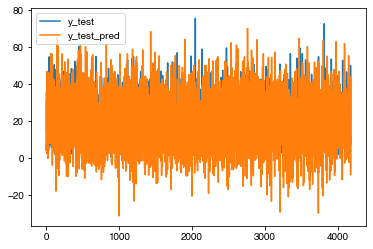

In [308]:
diff = pd.DataFrame(list(zip(y_test, y_test_pred)), columns = ['y_test', 'y_test_pred'])
diff.plot()

## Gradient Boosting

In [306]:
gr_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('linear_model', GradientBoostingRegressor(random_state=0, 
                                                            n_estimators = 100))])

pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

gr_end = time.time()
print(f"Runtime of the gr model is {gr_end - gr_start}")

6.687780958926599
6.904406204832437
Runtime of the gr model is 2.2683820724487305


## Ridge Regression

In [333]:
rr_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('linear_model', Ridge(alpha=50))])

pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

rr_end = time.time()
print(f"Runtime of the ridge model is {rr_end - rr_start}")

5.728880524328511
6.833223113862996
Runtime of the ridge model is 0.24019098281860352


## Lasso Regression

In [310]:
lass_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('linear_model', linear_model.Lasso(alpha=0.1))])

pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

lass_end = time.time()
print(f"Runtime of the lasso model is {lass_end - lass_start}")

7.106797146609629
7.111347658556213
Runtime of the lasso model is 2.671053171157837


## Random Forrest Regression

In [341]:
random_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('forest_model', RandomForestRegressor())])

pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

random_end = time.time()
print(f"Runtime of the random forrest model is {random_end - random_start}")

2.568166649563879
6.887907110366291
Runtime of the lasso model is 292.8528788089752


In [342]:
param_grid = {
    "forest_model__n_estimators": [50, 100, 150, 200, 250, 300],
    "forest_model__max_depth": [10, 50, 100]
    
}
search = GridSearchCV(pipe, param_grid, n_jobs=2)
search.fit(X_test, y_test)
print("Best parameter (CV score=%0.3f):" % search.best_score_)
print(search.best_params_)

Best parameter (CV score=0.149):
{'forest_model__max_depth': 100, 'forest_model__n_estimators': 250}


# Refining Model

After testing a few models, Gradient Boosting was performing the best out of all of the initial tests and beating the basline linear regression model by about 5%. At this point, I decided to use Gradient Boosting and improve the parameters on that model as much as possible.

In [339]:
gr_start = time.time()
pipe = Pipeline([('onehotencoder', OneHotEncoder(handle_unknown='ignore')),
                 ('gb_model', GradientBoostingRegressor(random_state=0, 
                                                            n_estimators = 100,
                                                       max_depth = 6,
                                                       learning_rate = 0.1))])

pipe.fit(X_train, y_train)
y_train_pred = pipe.predict(X_train)
y_test_pred = pipe.predict(X_test)
print(mean_absolute_error(y_train, y_train_pred))
print(mean_absolute_error(y_test, y_test_pred))

gr_end = time.time()
print(f"Runtime of the gr model is {gr_end - gr_start}")

6.161199582190048
6.854903200688206
Runtime of the gr model is 5.184422969818115


In [338]:
param_grid = {
    "gb_model__n_estimators": [50, 100, 150, 200, 250, 300],
    "gb_model__learning_rate": [.001, .01, .1],
    "gb_model__max_depth": [3, 6, 9, 12]
    
}
search = GridSearchCV(pipe, param_grid, n_jobs=2)
search.fit(X_test, y_test)
print("Best parameter (CV score=%0.3f):" % search.best_score_)
print(search.best_params_)

Best parameter (CV score=0.144):
{'gb_model__learning_rate': 0.1, 'gb_model__max_depth': 6, 'gb_model__n_estimators': 100}
